## Install Detectron2

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 6.6MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=65babd49cbc5cbb7aee4a284b3898b0de15dc8d0c21b85f6f7d8fa97ca6aee3e
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.8.1+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Requirement already up-to-date: torch in /usr/local/lib/python3.7/dist-packages (1.8.1+cu101)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.7/dist-packages (0.9.1+cu101)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-rc_401ft
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-rc_401ft
  Created wheel for fvcore: filename=fvcore-0.1.5-cp37-none-any.whl size=63295 sha256=6c46fb8a8aec2243217865441f3e40dff64a809ff1bd3e58f032426b833363df
  Stored in directory: /tmp/pip-ephem-wheel-cache-v0ytc8xu/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
Successfully built fvcore
Cloning into 'detectron2_repo'...
remote: Enumerating objects: 12018, done.
remote: Counting objects: 100% (681/681), done.
remote: Compressing objects: 100% (345/345), done.
remote: Total 12018 (delta 373), reused 607 (delta 333), pack-reused 11337
Receiving objects: 100% (12018/12018), 4.90 MiB | 18.38 MiB

In [ ]:
!pip install easycore

## Upload dataset


In [ ]:
# add google files directory to colab files
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# decompress the data
!unzip /content/drive/MyDrive/colab_files/Documents/VOC2021.zip > /dev/null

replace VOC2021/.DS_Store? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

## Import necessary libraries

In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
import detectron2
import torch
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import json
import os
import random
from google.colab.patches import cv2_imshow
from detectron2.structures import BoxMode
# import some common detectron2 utilities

from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import glob

from easycore.common.path import PathManager
import xml.etree.ElementTree as ET 

## Register for our dataset in VOC format

In [ ]:
# my dataset is in voc format
def get_layout_dicts(xml_dir, img_dir):
    class_names = ["title", "text"]
    xmls = glob.glob(os.path.join(xml_dir, "*.xml"))
    print(f"Find {len(xmls)} xmls!")

    dicts = []
    # for fileid in fileids:
    for xml in xmls:
        fileid = os.path.basename(xml).split(".")[0]
        jpeg_file = os.path.join(img_dir, f"{fileid}.jpg")

        with PathManager.open(xml) as f:
            tree = ET.parse(f)

        r = {
            "file_name": jpeg_file,
            "image_id": fileid,
            "height": int(tree.findall("./size/height")[0].text),
            "width": int(tree.findall("./size/width")[0].text),
        }
        instances = []

        for obj in tree.findall("object"):
            cls = obj.find("name").text
            # We include "difficult" samples in training.
            # Based on limited experiments, they don't hurt accuracy.
            # difficult = int(obj.find("difficult").text)
            # if difficult == 1:
            # continue
            bbox = obj.find("bndbox")
            bbox = [float(bbox.find(x).text) for x in ["xmin", "ymin", "xmax", "ymax"]]
            # Original annotations are integers in the range [1, W or H]
            # Assuming they mean 1-based pixel indices (inclusive),
            # a box with annotation (xmin=1, xmax=W) covers the whole image.
            # In coordinate space this is represented by (xmin=0, xmax=W)
            bbox[0] -= 1.0
            bbox[1] -= 1.0
            instances.append(
                {"category_id": class_names.index(cls), "bbox": bbox, "bbox_mode": BoxMode.XYXY_ABS}
            )
        r["annotations"] = instances
        dicts.append(r)
    return dicts

In [ ]:
for d in ("train", "test"):
    DatasetCatalog.register(f"layout5_{d}",
                            lambda d=d: get_layout_dicts(f"/content/VOC2021/Annotations/{d}","/content/VOC2021/JPEGImages/"))
    MetadataCatalog.get(f"layout5_{d}").set(thing_classes=["title", "text"])

In [ ]:
layout_metadata = MetadataCatalog.get("layout5_train")

### To verify the data loading is correct

Find 429 xmls!


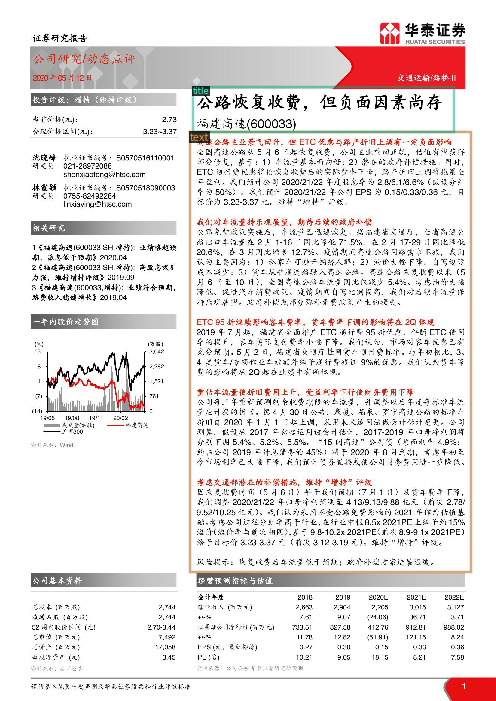

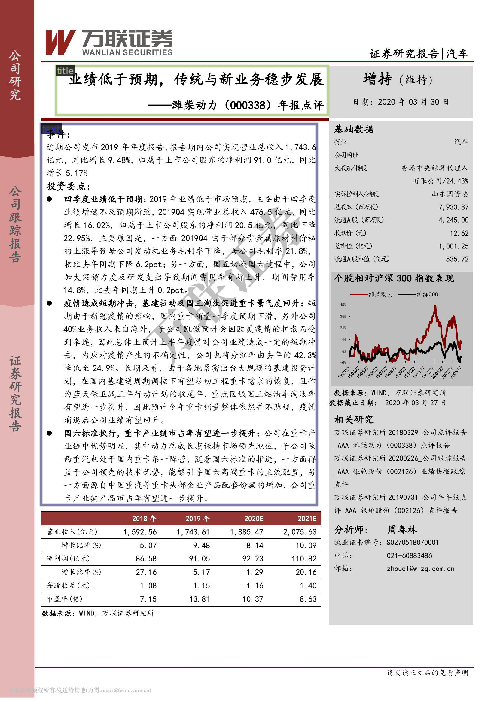

In [ ]:
import random
from detectron2.utils.visualizer import Visualizer

dataset_dicts = get_layout_dicts("/content/VOC2021/Annotations/train/", "/content/VOC2021/JPEGImages/")
for d in random.sample(dataset_dicts, 2):
         img = cv2.imread(d["file_name"])
         visualizer = Visualizer(img[:, :, ::-1], metadata=layout_metadata, scale=0.3)
         vis = visualizer.draw_dataset_dict(d)
         cv2_imshow(vis.get_image()[:, :, ::-1])

## train 
Let's fine-tune a Prima Layout model on the stock dataset

### Config and Initial set

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.checkpoint import DetectionCheckpointer


import os

cfg = get_cfg()

cfg.merge_from_file("/content/drive/MyDrive/colab_files/Documents/config.yaml")
cfg.DATASETS.TRAIN = ("layout5_train",)
# cfg.CUDNN_BENCHMARK = True
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 4
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("PascalVOC-Detection/faster_rcnn_R_50_C4.yaml")  # Let training initialize from model zoo
cfg.MODEL.MASK_ON = False
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/colab_files/Documents/model_final.pth"

cfg.SOLVER.IMS_PER_BATCH = 8

cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.WARMUP_ITER = 100
cfg.SOLVER.MAX_ITER = 800    

cfg.SOLVER.STEPS = []       # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # two classes: title and text. (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
cfg.OUTPUT_DIR = "/content/outputs/prima/mask_rcnn_R_50_FPN_3x/"
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.
print(cfg.dump())  # print formatted configs

CUDNN_BENCHMARK: false
DATALOADER:
  ASPECT_RATIO_GROUPING: true
  FILTER_EMPTY_ANNOTATIONS: true
  NUM_WORKERS: 4
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: []
  PROPOSAL_FILES_TRAIN: []
  TEST: []
  TRAIN:
  - layout5_train
GLOBAL:
  HACK: 1.0
INPUT:
  CROP:
    ENABLED: false
    SIZE:
    - 0.9
    - 0.9
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN:
  - 640
  - 672
  - 704
  - 736
  - 768
  - 800
  MIN_SIZE_TRAIN_SAMPLING: choice
  RANDOM_FLIP: horizontal
MODEL:
  ANCHOR_GENERATOR:
    ANGLES:
    - - -90
      - 0
      - 90
    ASPECT_RATIOS:
    - - 0.5
      - 1.0
      - 2.0
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES:
    - - 32
    - - 64
    - - 128
    - - 256
    - - 512
  BACKBONE:
    FREEZE_AT: 2
    NAME: build_resnet_fpn_backbone


### Model Training

In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/06 19:29:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (8, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (8,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (28, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (28,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight

[05/06 19:29:07 d2.engine.train_loop]: Starting training from iteration 0
[05/06 19:29:32 d2.utils.events]:  eta: 0:15:48  iter: 19  total_loss: 1.156  loss_cls: 0.9274  loss_box_reg: 0.04088  loss_rpn_cls: 0.1199  loss_rpn_loc: 0.05377  time: 1.2196  data_time: 0.0843  lr: 6.1816e-06  max_mem: 8145M
[05/06 19:29:56 d2.utils.events]:  eta: 0:15:24  iter: 39  total_loss: 0.5453  loss_cls: 0.3295  loss_box_reg: 0.05713  loss_rpn_cls: 0.09738  loss_rpn_loc: 0.05831  time: 1.2162  data_time: 0.0445  lr: 1.2425e-05  max_mem: 8145M
[05/06 19:30:21 d2.utils.events]:  eta: 0:15:07  iter: 59  total_loss: 0.3675  loss_cls: 0.1616  loss_box_reg: 0.08994  loss_rpn_cls: 0.07184  loss_rpn_loc: 0.0568  time: 1.2223  data_time: 0.0301  lr: 1.8669e-05  max_mem: 8145M
[05/06 19:30:46 d2.utils.events]:  eta: 0:14:44  iter: 79  total_loss: 0.382  loss_cls: 0.1551  loss_box_reg: 0.1257  loss_rpn_cls: 0.0495  loss_rpn_loc: 0.04976  time: 1.2278  data_time: 0.0424  lr: 2.4913e-05  max_mem: 8145M
[05/06 19:31

In [ ]:
# Look at training curves in tensorboard:
%reload_ext tensorboard
%tensorboard --logdir outputs/prima/mask_rcnn_R_50_FPN_3x

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Find 199 xmls!


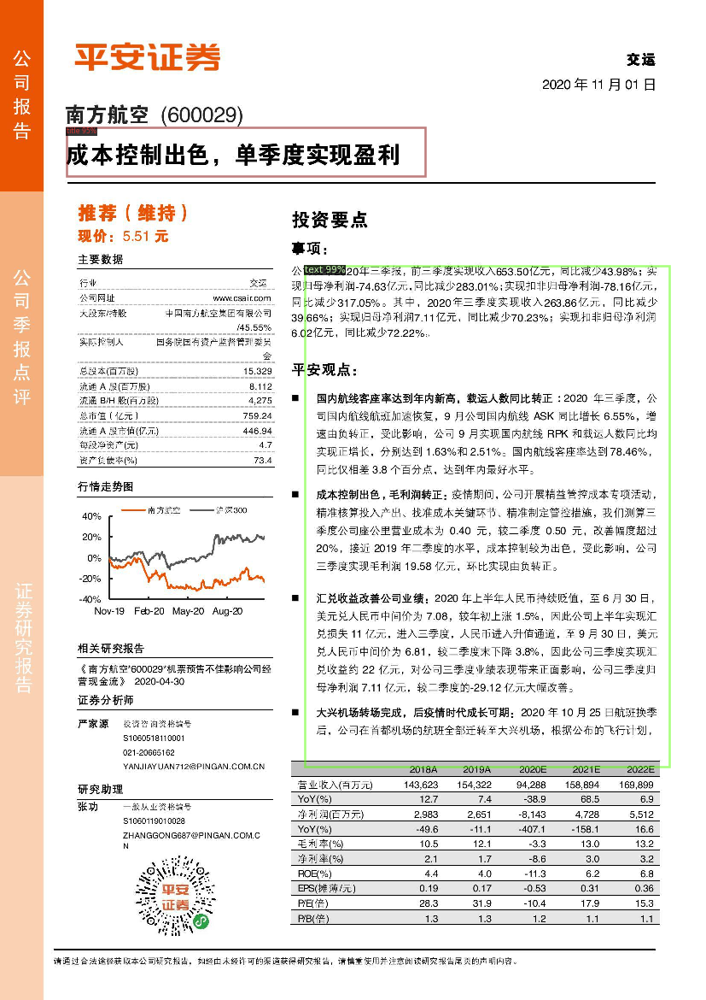

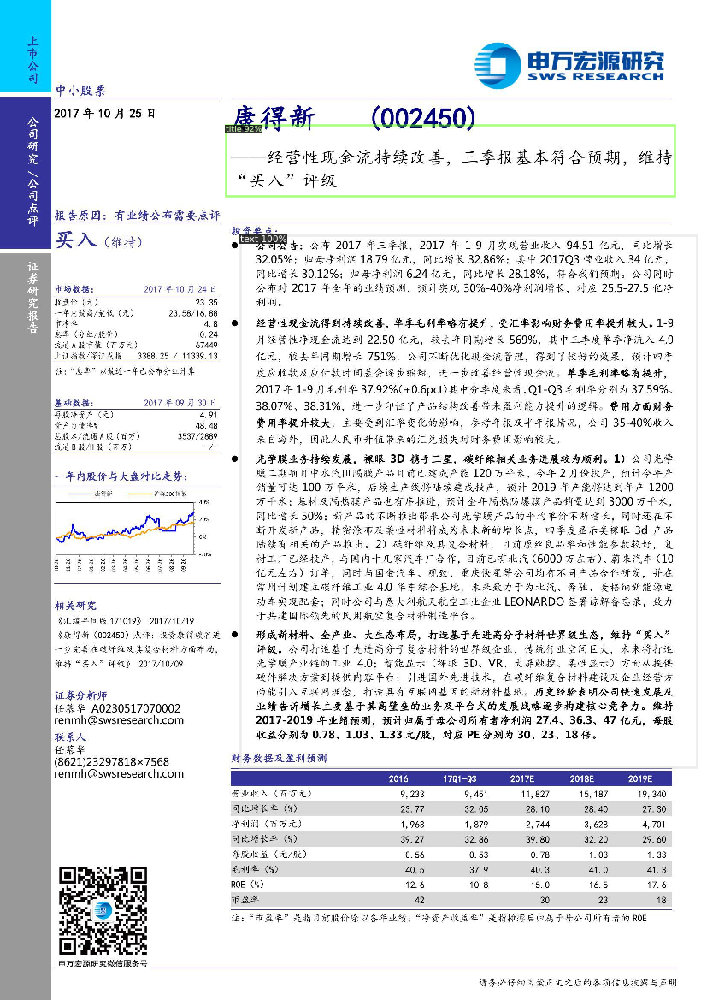

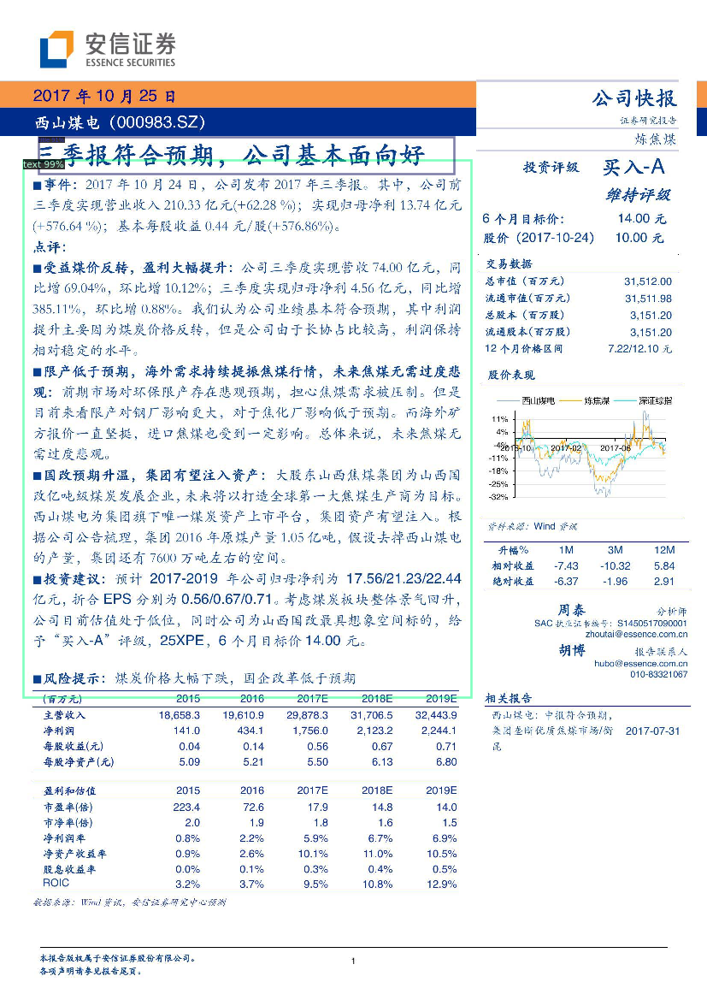

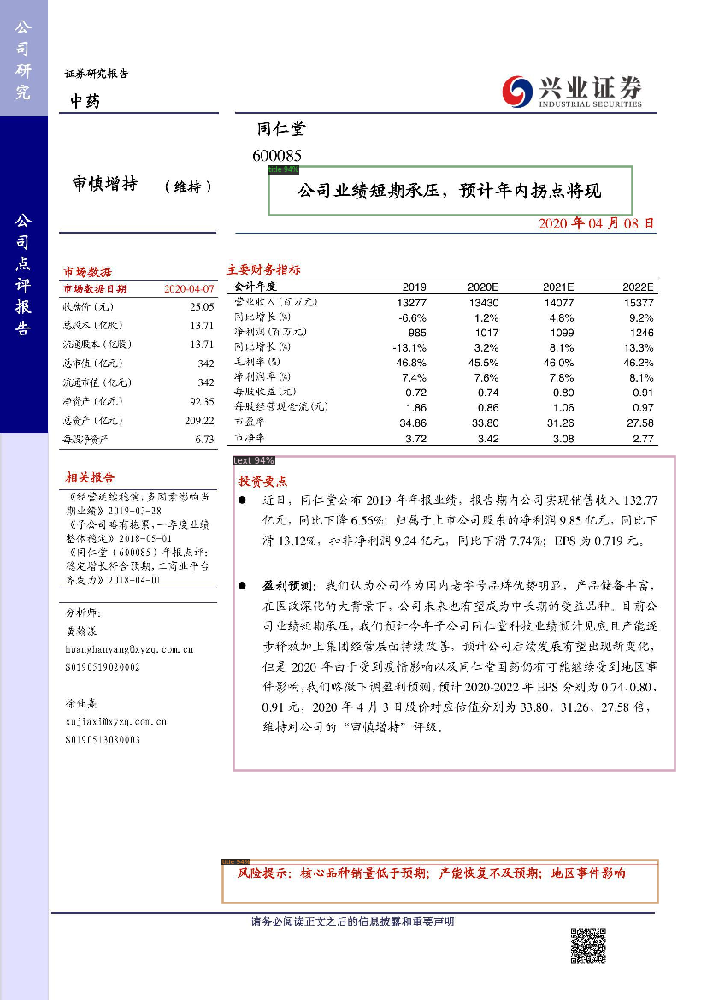

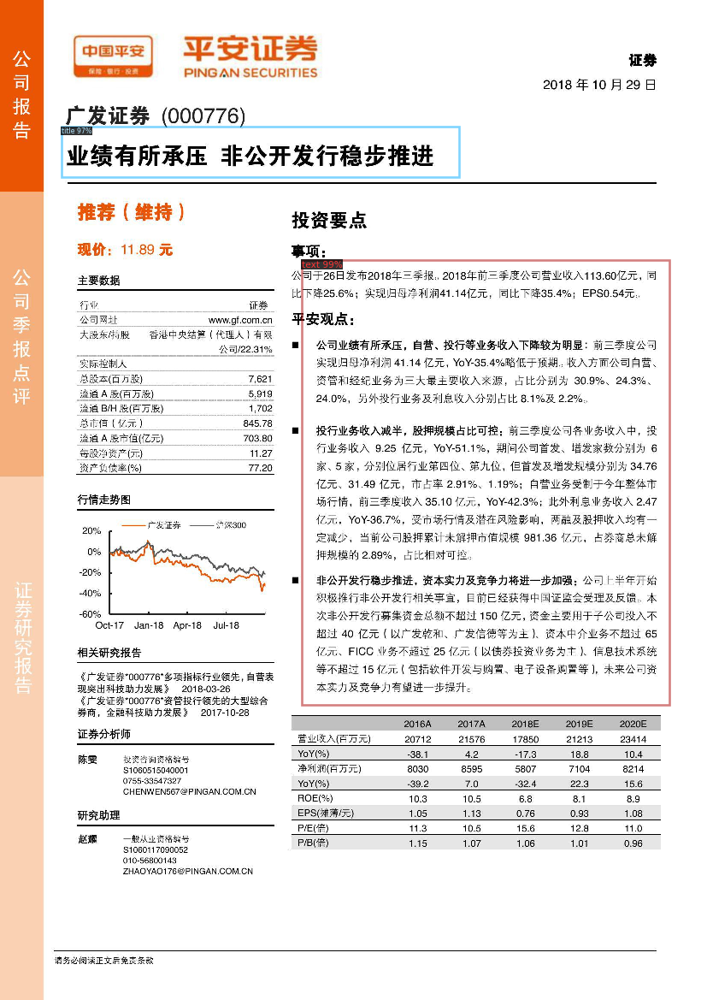

...

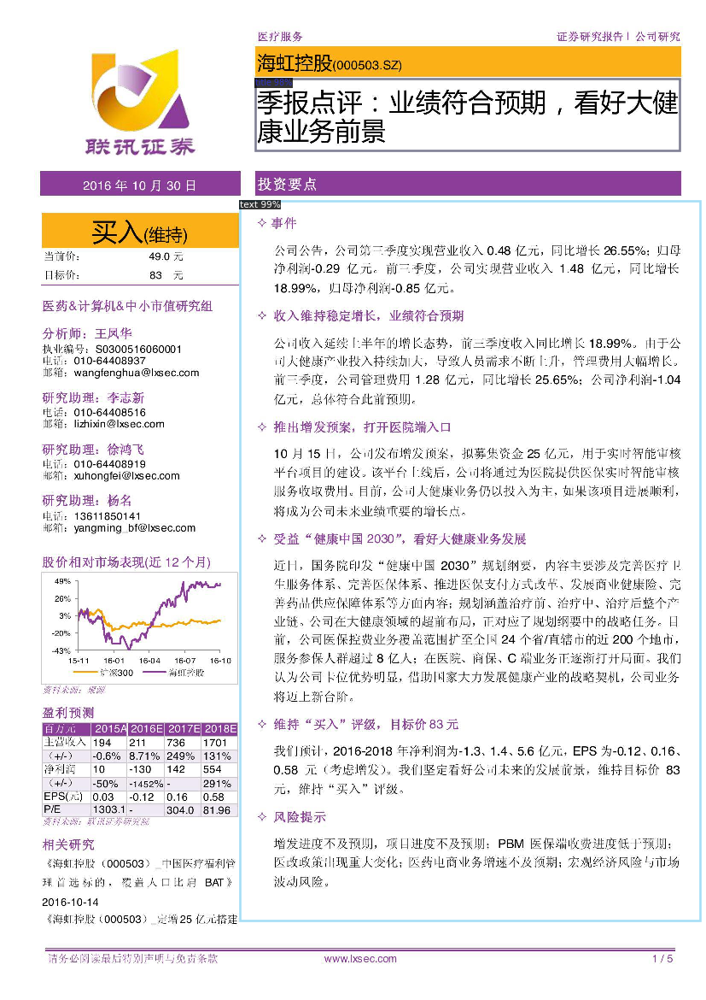

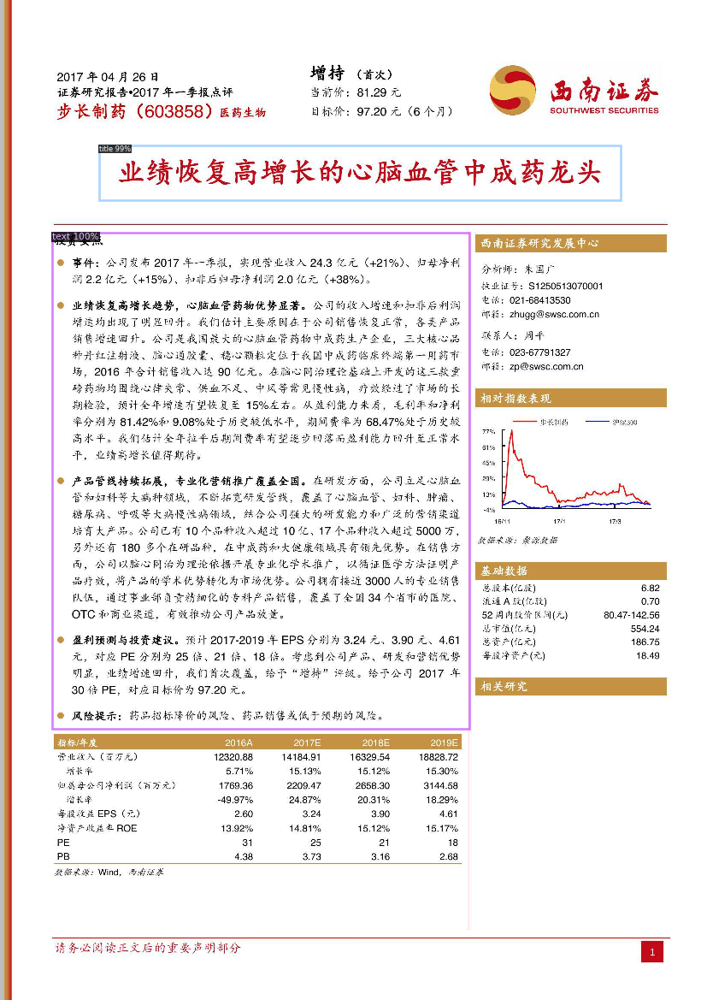

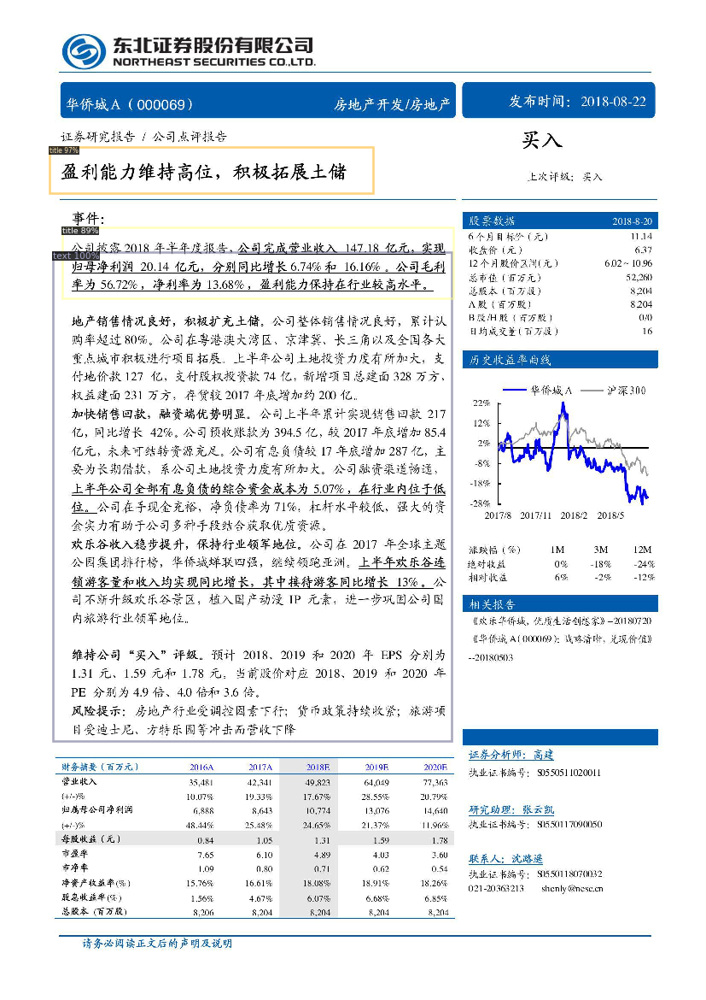

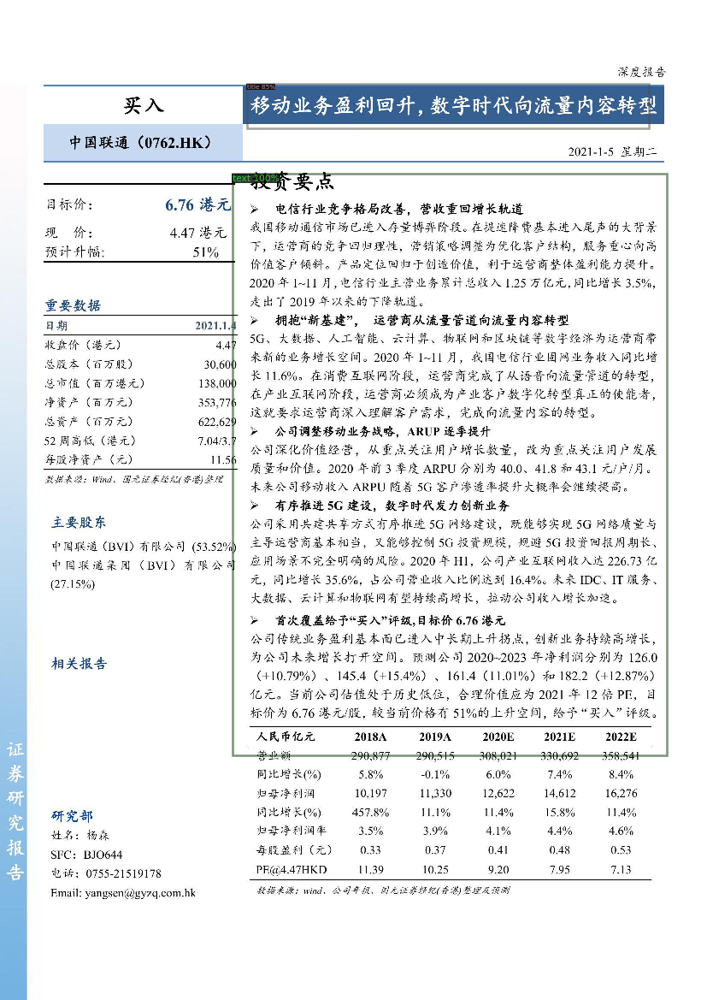

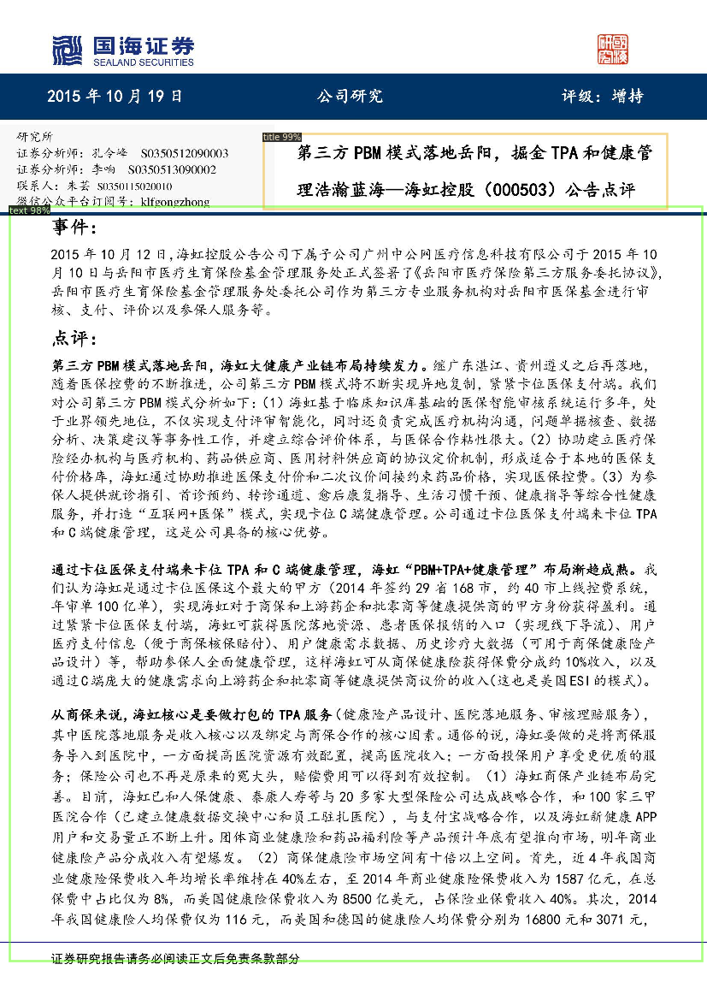

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_layout_dicts("/content/VOC2021/Annotations/test", "/content/VOC2021/JPEGImages/")
for d in random.sample(dataset_dicts,12):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=layout_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
!cp -r /content/outputs /content/drive/MyDrive/colab_files/

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("layout5_test", cfg, False, output_dir="./output/")
test_loader = build_detection_test_loader(cfg, "layout5_test")
print(inference_on_dataset(trainer.model, test_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

WARNING [05/01 18:55:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[05/01 18:55:00 d2.evaluation.coco_evaluation]: 'layout5_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[05/01 18:55:00 d2.data.datasets.coco]: Converting annotations of dataset 'layout5_test' to COCO format ...)
Find 199 xmls!
[05/01 18:55:00 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[05/01 18:55:00 d2.data.datasets.coco]: Conversion finished, #images: 199, #annotations: 403
[05/01 18:55:00 d2.data.datasets.coco]: Caching COCO format annotations at './output/layout5_test_coco_format.json' ...
Find 199 xmls!
[05/01 18:55:00 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   title    | 199          |    text

In [ ]:
import torch
print(torch.cuda.device_count())

1


In [ ]:
os.environ['CUDA_VISIBLE_DEVICES']='2, 3'

In [ ]:
torch.cuda.empty_cache()